In [2]:
!kaggle datasets download -d vishalkundar/gandata20

100% 2.32G/2.32G [01:18<00:00, 37.9MB/s]
100% 2.32G/2.32G [01:18<00:00, 31.7MB/s]


In [3]:
!unzip gandata20.zip

Archive:  gandata20.zip
  inflating: birds/test/256images.pickle  
  inflating: birds/test/64images.pickle  
  inflating: birds/test/char-CNN-RNN-embeddings.pickle  
  inflating: birds/train/256images.pickle  
  inflating: birds/train/64images.pickle  
  inflating: birds/train/char-CNN-RNN-embeddings.pickle  


In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import keras
import numpy as np
from keras import layers
import tensorflow as tf


In [60]:
import pickle
data = pickle.load(open('birds/train/64images.pickle', 'rb'))
data1 = pickle.load(open('birds/test/64images.pickle', 'rb'))
data = np.asarray(data+data1)
data = (data.astype(np.float32) - 127.5) / 127.5
data.shape

(11788, 64, 64, 3)

In [61]:
optim = keras.optimizers.Adam(lr=0.0002, beta_1=0.5)

/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [20]:
def make_discriminator():
    disc = keras.Sequential([
    layers.Conv2D(64, (3,3), padding='same', input_shape=(64,64,3)),
    layers.LeakyReLU(alpha=0.2),
        
    layers.Conv2D(128, (3,3), strides=(2,2), padding='same'),
    layers.LeakyReLU(alpha=0.2),
        
    layers.Conv2D(128, (3,3), strides=(2,2), padding='same'),
    layers.LeakyReLU(alpha=0.2),
        
    layers.Conv2D(128, (3,3), strides=(2,2), padding='same'),
    layers.LeakyReLU(alpha=0.2),
        
    layers.Flatten(),
    layers.Dropout(0.4),
    layers.Dense(1, activation='sigmoid'),
    ])
    disc.compile(optimizer=optim, loss='binary_crossentropy')
    return disc


In [19]:
def make_generator():
    gen = keras.Sequential(
    [
        layers.Dense(8*8*256, input_dim=128),
        layers.LeakyReLU(alpha=0.2),
        layers.Reshape((8, 8, 256)),

        layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
     
        layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),

        layers.Conv2D(3, (3,3), activation='tanh', padding='same')
        
    ])
    gen.compile(loss='categorical_crossentropy', optimizer=optim)
    return gen

In [62]:
gen = make_generator()
disc = make_discriminator()
disc.trainable = False
model = keras.Sequential([gen, disc])
model.compile(loss='binary_crossentropy', optimizer=optim)

In [63]:
def generate():
  noise = np.random.normal(0, 1, size=[10, 128])
  imgs = gen.predict(noise)
  imgs = (imgs+1)/2
  fig, axs = plt.subplots(1, 10, figsize=(50, 50))
  for i in range(10):
    axs[i].imshow(imgs[i].reshape(64,64,3))
    axs[i].axis('off')
  plt.show()

1/1 [==============================] - 0s 87ms/step


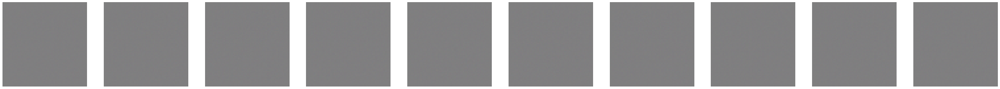

In [64]:
generate()

In [65]:
def train(epochs, batch_size):
  n_batches = data.shape[0]//batch_size
  for e in range(epochs+1):
    print(f'epoch {e}')
    for i in range(n_batches):
      noise = np.random.normal(0, 1, size=[batch_size, 128])
      real_batch = data[np.random.randint(0, data.shape[0], size=batch_size)]
      fake_batch = gen.predict(noise, verbose=0)
      x = np.concatenate([fake_batch, real_batch])
      y = np.zeros(2*batch_size)
      y[batch_size:] = 0.9
      disc.trainable = True
      disc.train_on_batch(x,y)
      disc.trainable = False
      noise = np.random.normal(0, 1, size=[batch_size, 128])
      y = np.ones(batch_size)
      model.train_on_batch(noise, y)
    generate()


epoch 0
1/1 [==============================] - 0s 15ms/step


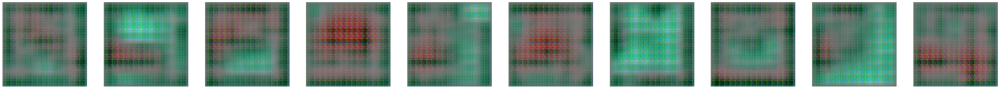

epoch 1
1/1 [==============================] - 0s 18ms/step


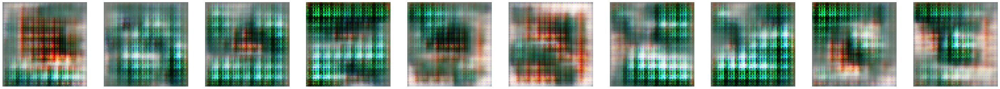

epoch 2
1/1 [==============================] - 0s 16ms/step


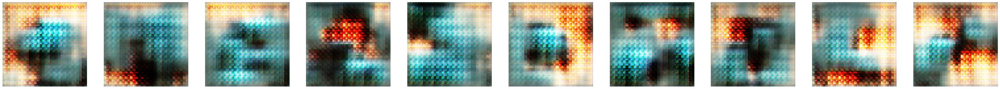

epoch 3
1/1 [==============================] - 0s 17ms/step


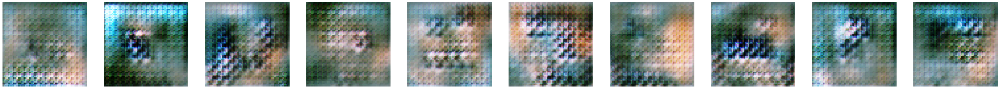

epoch 4
1/1 [==============================] - 0s 15ms/step


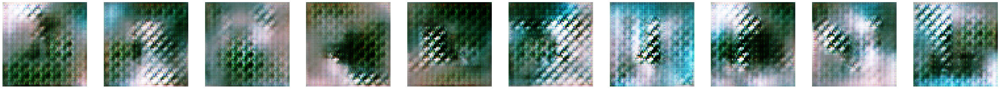

epoch 5
1/1 [==============================] - 0s 15ms/step


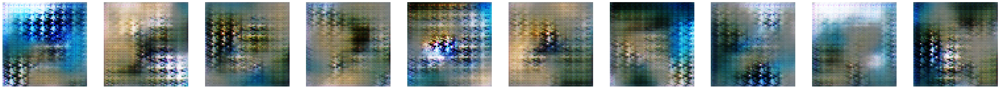

epoch 6
1/1 [==============================] - 0s 17ms/step


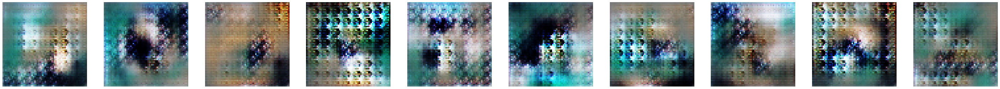

epoch 7
1/1 [==============================] - 0s 16ms/step


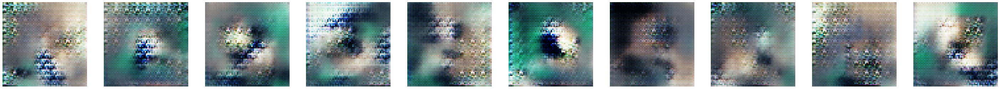

epoch 8
1/1 [==============================] - 0s 17ms/step


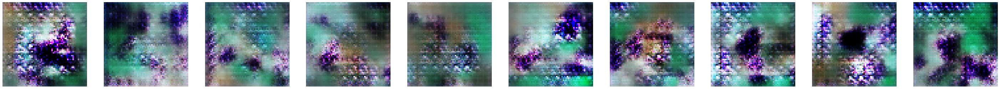

epoch 9
1/1 [==============================] - 0s 15ms/step


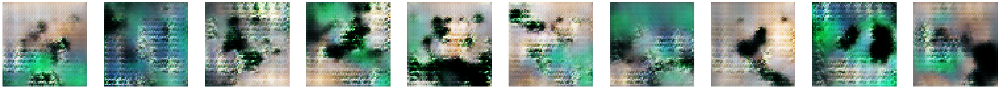

epoch 10
1/1 [==============================] - 0s 15ms/step


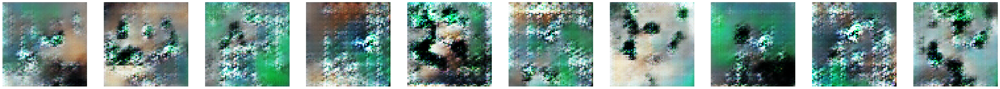

epoch 11
1/1 [==============================] - 0s 15ms/step


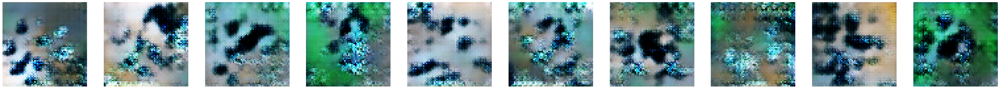

epoch 12
1/1 [==============================] - 0s 16ms/step


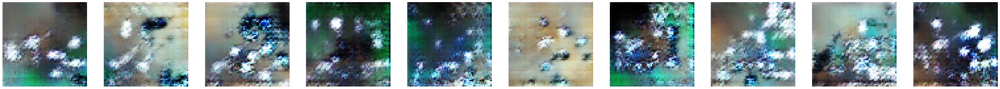

epoch 13
1/1 [==============================] - 0s 16ms/step


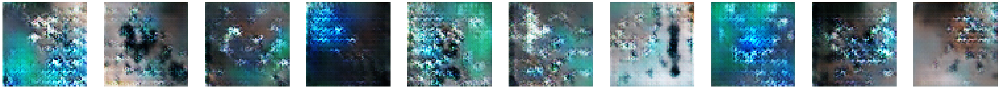

epoch 14
1/1 [==============================] - 0s 19ms/step


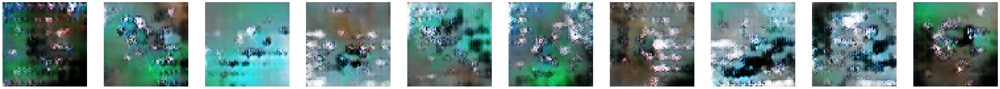

epoch 15
1/1 [==============================] - 0s 15ms/step


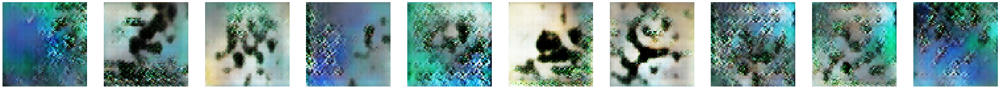

epoch 16
1/1 [==============================] - 0s 16ms/step


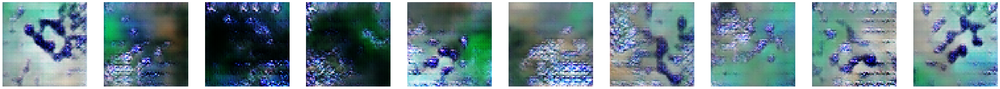

epoch 17
1/1 [==============================] - 0s 15ms/step


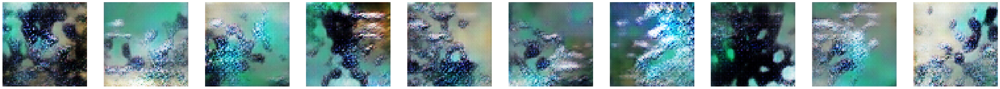

epoch 18
1/1 [==============================] - 0s 23ms/step


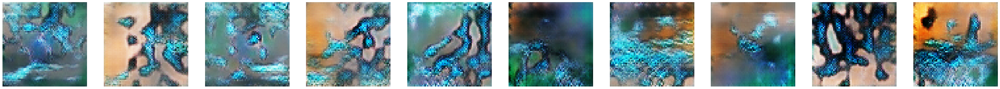

epoch 19
1/1 [==============================] - 0s 15ms/step


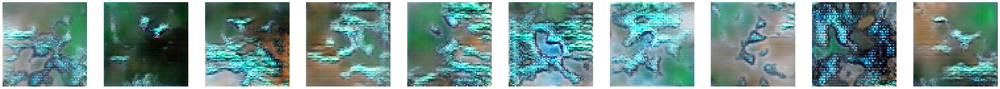

epoch 20
1/1 [==============================] - 0s 19ms/step


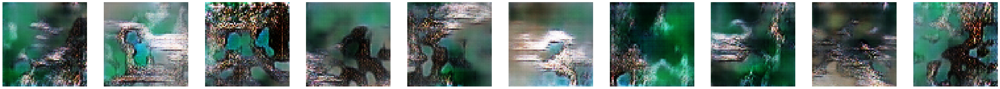

epoch 21
1/1 [==============================] - 0s 17ms/step


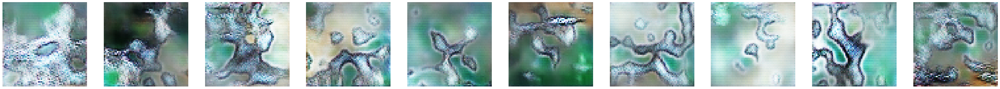

epoch 22
1/1 [==============================] - 0s 21ms/step


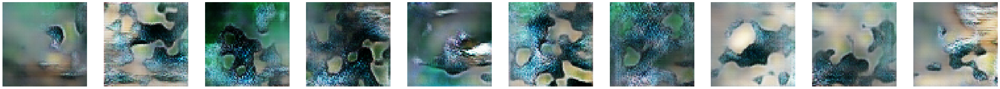

epoch 23
1/1 [==============================] - 0s 17ms/step


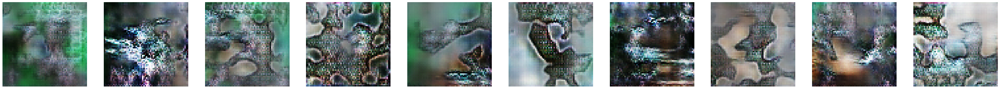

epoch 24
1/1 [==============================] - 0s 16ms/step


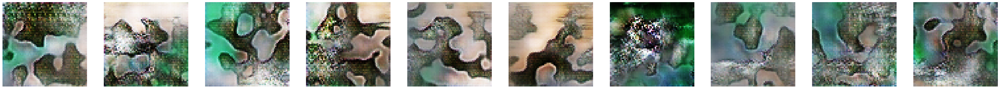

epoch 25
1/1 [==============================] - 0s 18ms/step


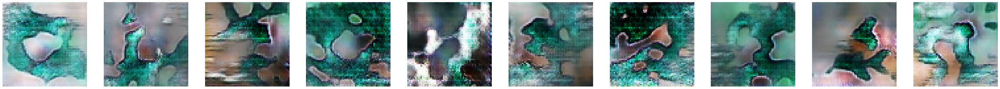

epoch 26
1/1 [==============================] - 0s 16ms/step


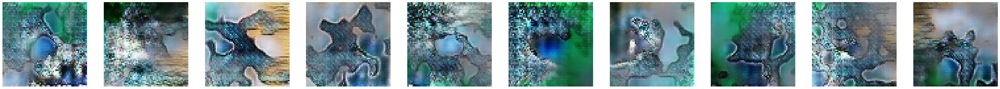

epoch 27
1/1 [==============================] - 0s 16ms/step


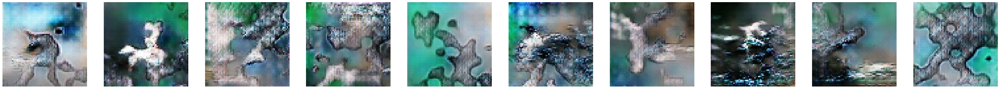

epoch 28
1/1 [==============================] - 0s 18ms/step


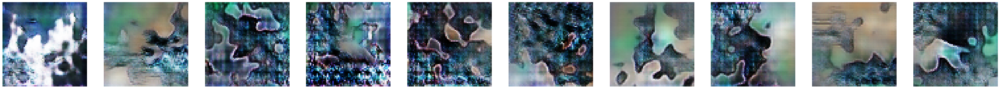

epoch 29
1/1 [==============================] - 0s 18ms/step


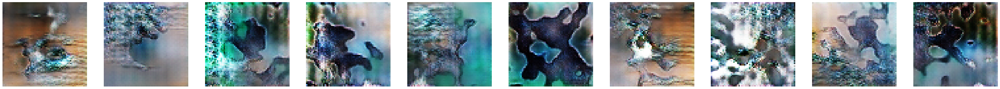

epoch 30
1/1 [==============================] - 0s 15ms/step


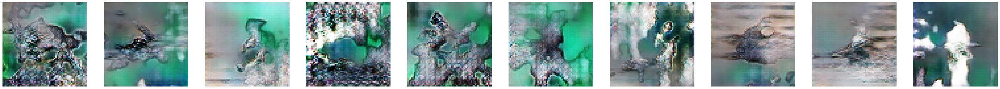

epoch 31
1/1 [==============================] - 0s 18ms/step


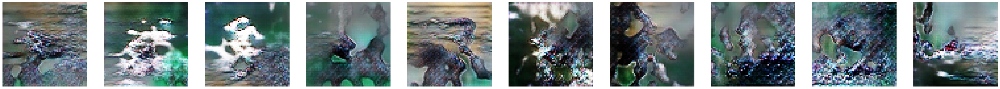

epoch 32
1/1 [==============================] - 0s 17ms/step


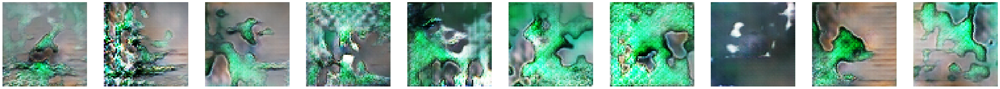

epoch 33
1/1 [==============================] - 0s 16ms/step


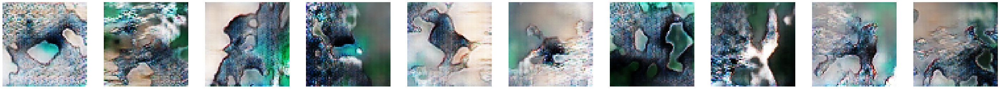

epoch 34
1/1 [==============================] - 0s 19ms/step


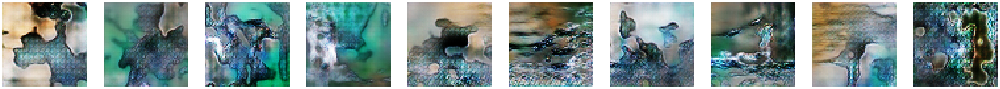

epoch 35
1/1 [==============================] - 0s 17ms/step


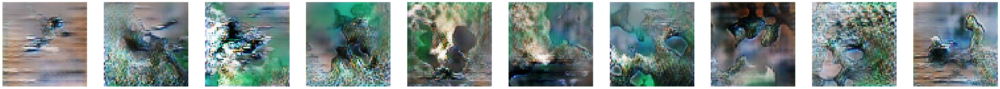

epoch 36
1/1 [==============================] - 0s 15ms/step


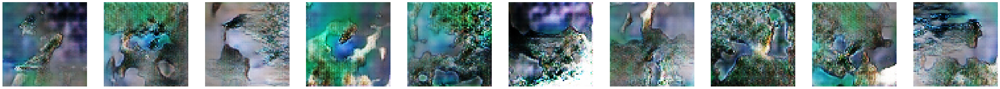

epoch 37
1/1 [==============================] - 0s 16ms/step


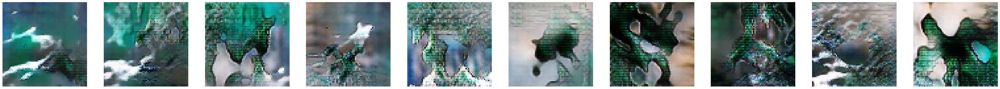

epoch 38
1/1 [==============================] - 0s 16ms/step


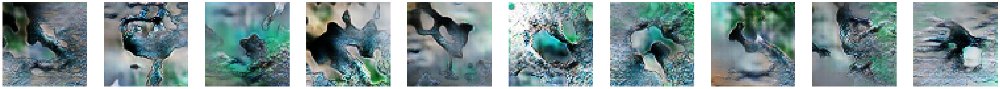

epoch 39
1/1 [==============================] - 0s 17ms/step


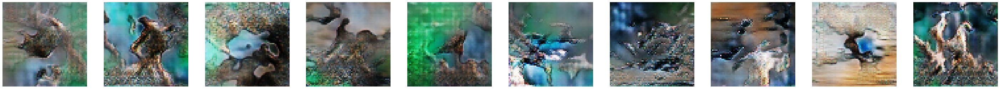

epoch 40
1/1 [==============================] - 0s 26ms/step


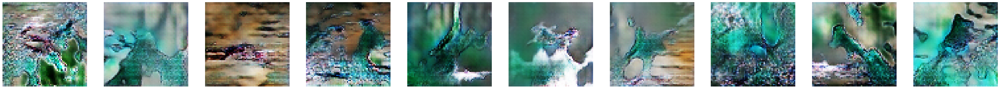

epoch 41
1/1 [==============================] - 0s 18ms/step


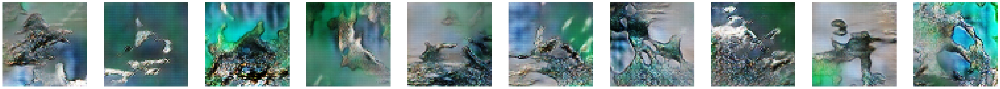

epoch 42
1/1 [==============================] - 0s 17ms/step


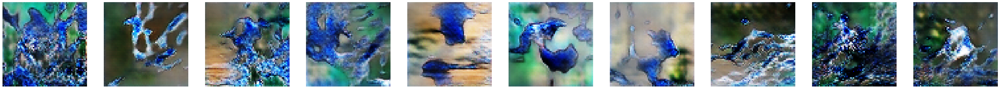

epoch 43
1/1 [==============================] - 0s 17ms/step


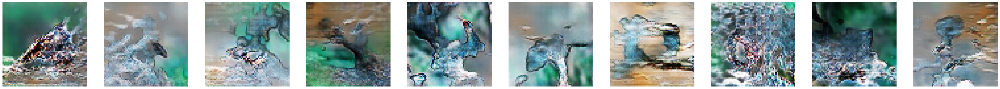

epoch 44
1/1 [==============================] - 0s 16ms/step


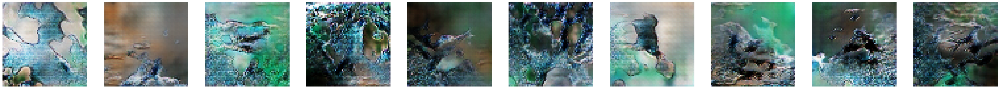

epoch 45
1/1 [==============================] - 0s 19ms/step


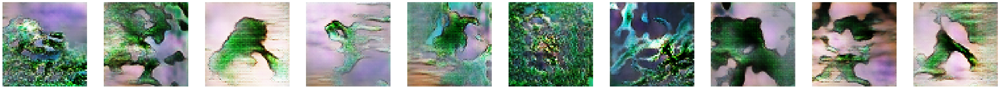

epoch 46
1/1 [==============================] - 0s 16ms/step


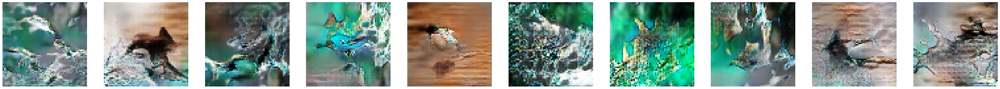

epoch 47
1/1 [==============================] - 0s 17ms/step


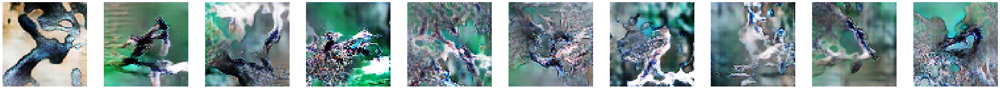

epoch 48
1/1 [==============================] - 0s 18ms/step


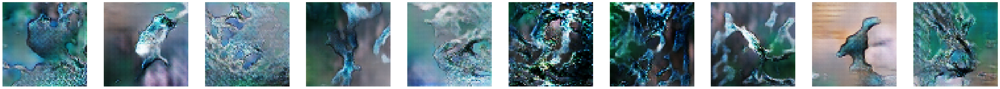

epoch 49
1/1 [==============================] - 0s 18ms/step


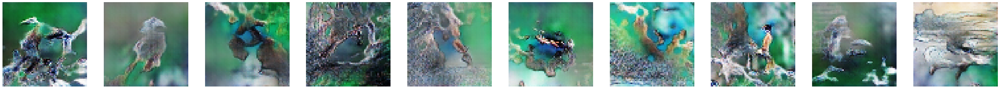

epoch 50
1/1 [==============================] - 0s 17ms/step


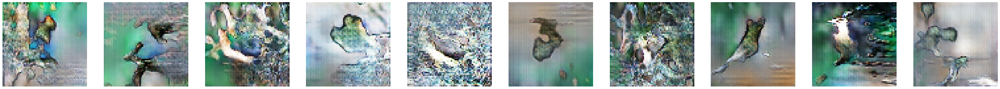

epoch 51
1/1 [==============================] - 0s 20ms/step


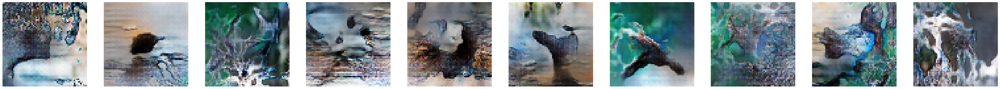

epoch 52
1/1 [==============================] - 0s 15ms/step


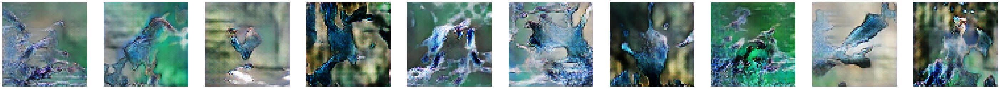

epoch 53
1/1 [==============================] - 0s 16ms/step


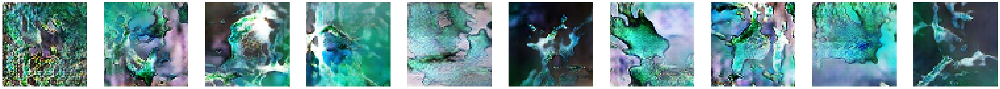

epoch 54
1/1 [==============================] - 0s 15ms/step


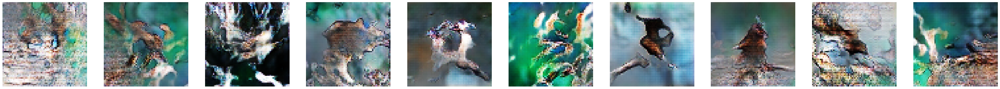

epoch 55
1/1 [==============================] - 0s 17ms/step


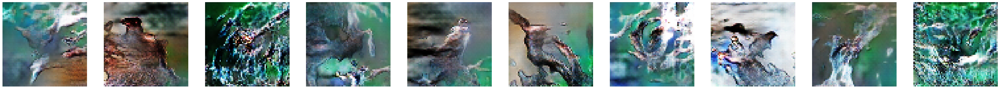

epoch 56
1/1 [==============================] - 0s 15ms/step


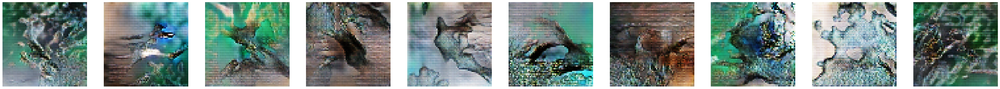

epoch 57
1/1 [==============================] - 0s 22ms/step


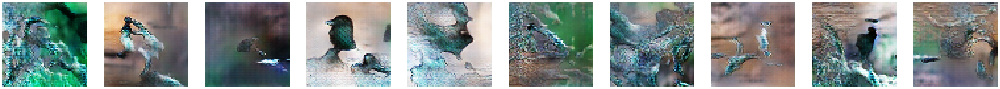

epoch 58
1/1 [==============================] - 0s 24ms/step


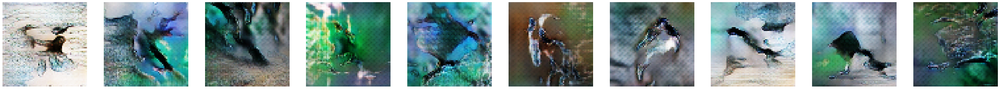

epoch 59
1/1 [==============================] - 0s 16ms/step


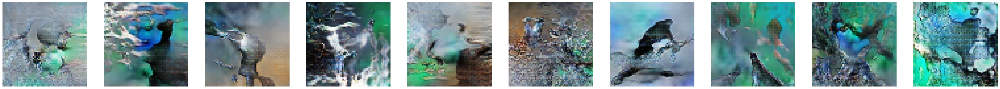

epoch 60
1/1 [==============================] - 0s 15ms/step


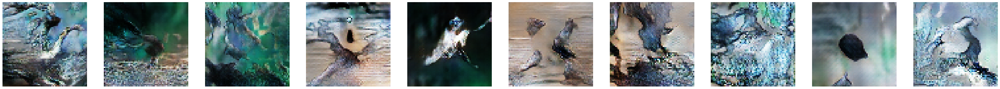

epoch 61
1/1 [==============================] - 0s 17ms/step


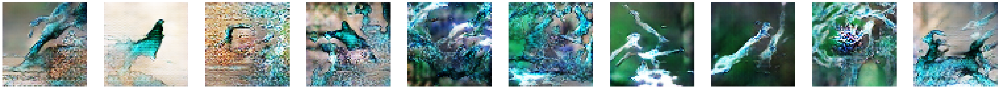

epoch 62
1/1 [==============================] - 0s 18ms/step


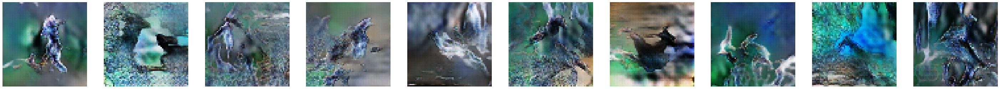

epoch 63
1/1 [==============================] - 0s 15ms/step


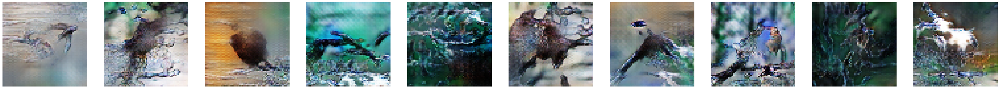

epoch 64
1/1 [==============================] - 0s 15ms/step


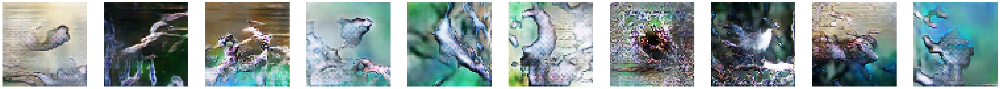

epoch 65
1/1 [==============================] - 0s 17ms/step


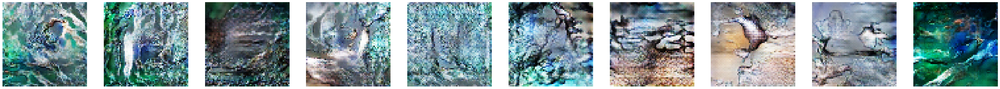

epoch 66
1/1 [==============================] - 0s 16ms/step


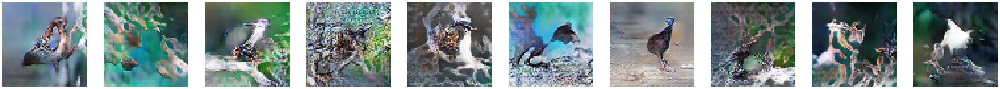

epoch 67
1/1 [==============================] - 0s 15ms/step


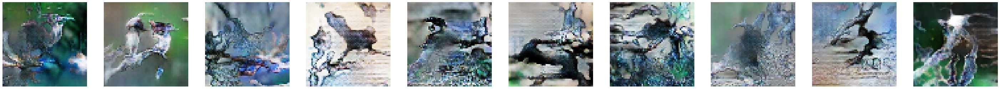

epoch 68
1/1 [==============================] - 0s 15ms/step


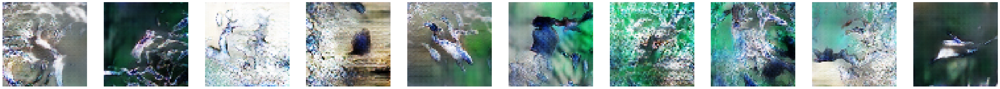

epoch 69
1/1 [==============================] - 0s 15ms/step


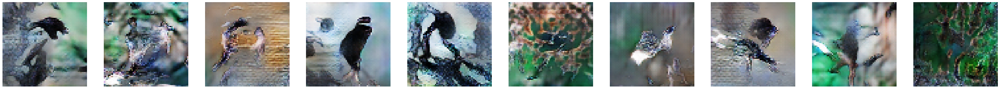

epoch 70
1/1 [==============================] - 0s 17ms/step


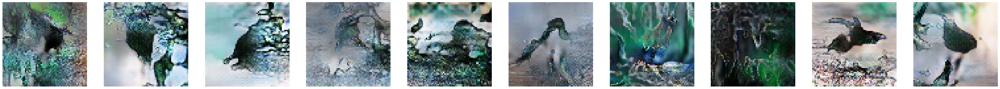

epoch 71
1/1 [==============================] - 0s 15ms/step


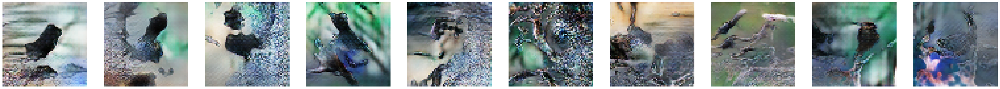

epoch 72
1/1 [==============================] - 0s 16ms/step


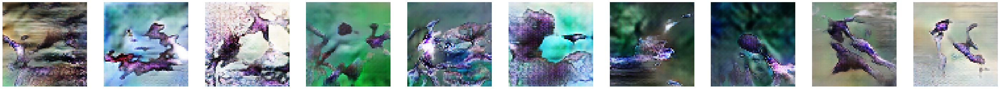

epoch 73
1/1 [==============================] - 0s 18ms/step


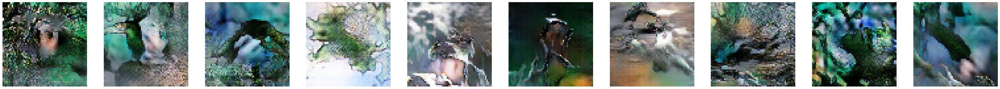

epoch 74
1/1 [==============================] - 0s 24ms/step


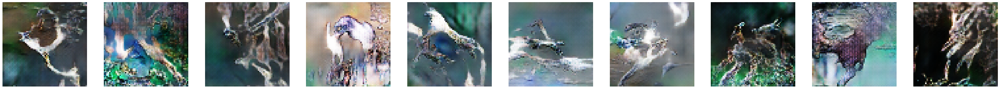

epoch 75
1/1 [==============================] - 0s 24ms/step


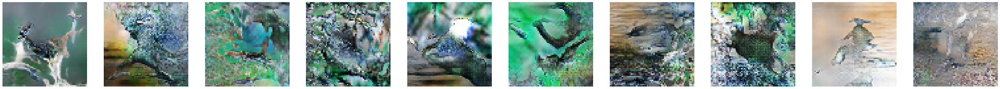

epoch 76
1/1 [==============================] - 0s 15ms/step


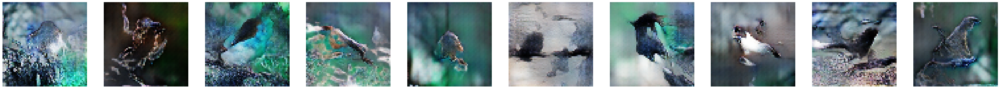

epoch 77
1/1 [==============================] - 0s 25ms/step


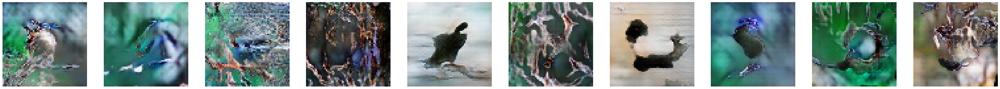

epoch 78
1/1 [==============================] - 0s 15ms/step


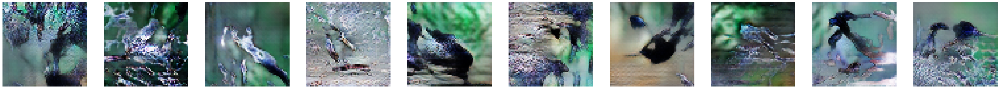

epoch 79
1/1 [==============================] - 0s 16ms/step


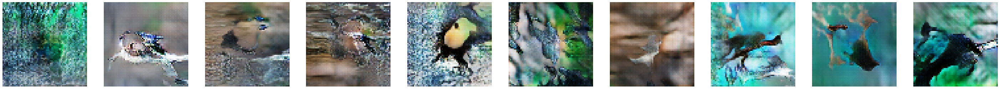

epoch 80
1/1 [==============================] - 0s 27ms/step


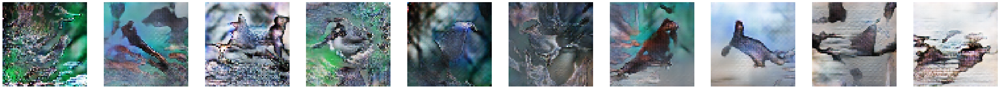

epoch 81
1/1 [==============================] - 0s 15ms/step


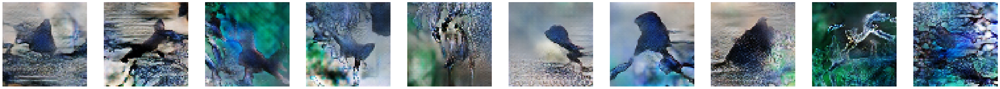

epoch 82
1/1 [==============================] - 0s 17ms/step


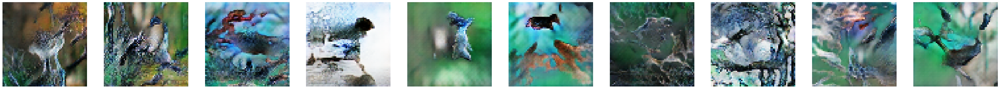

epoch 83
1/1 [==============================] - 0s 15ms/step


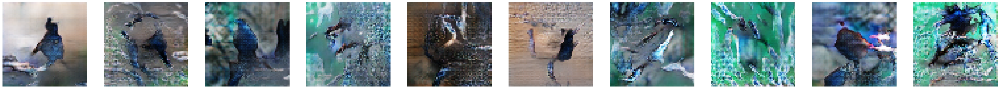

epoch 84
1/1 [==============================] - 0s 15ms/step


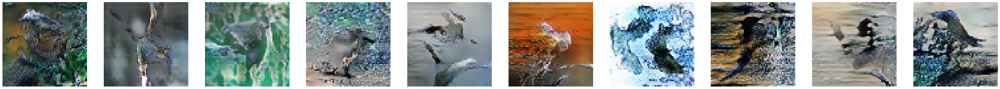

epoch 85
1/1 [==============================] - 0s 16ms/step


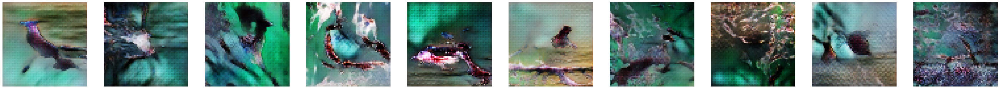

epoch 86
1/1 [==============================] - 0s 15ms/step


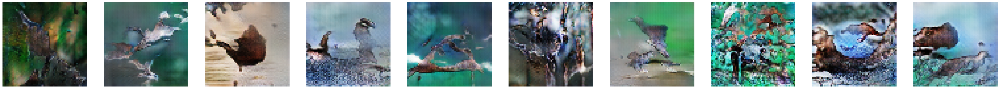

epoch 87
1/1 [==============================] - 0s 17ms/step


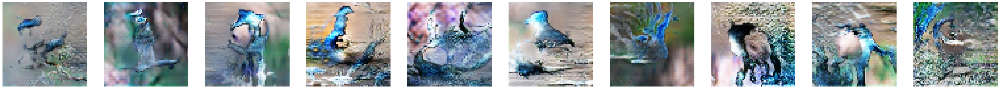

epoch 88
1/1 [==============================] - 0s 24ms/step


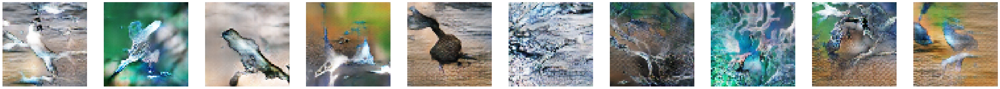

epoch 89
1/1 [==============================] - 0s 18ms/step


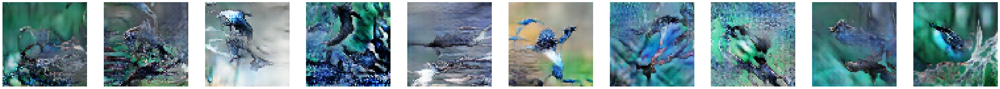

epoch 90
1/1 [==============================] - 0s 15ms/step


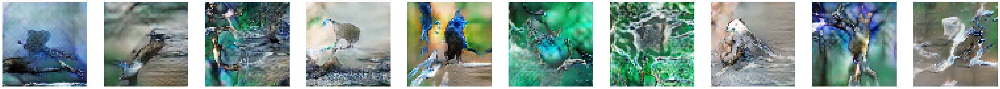

epoch 91
1/1 [==============================] - 0s 15ms/step


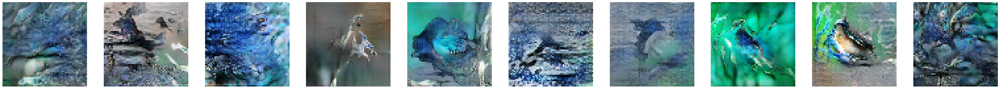

epoch 92
1/1 [==============================] - 0s 15ms/step


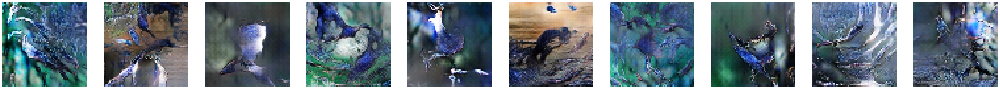

epoch 93
1/1 [==============================] - 0s 26ms/step


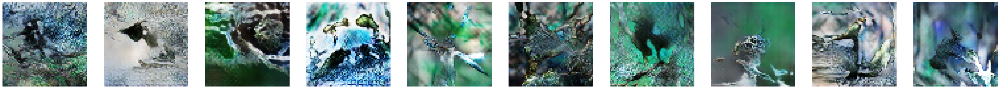

epoch 94
1/1 [==============================] - 0s 18ms/step


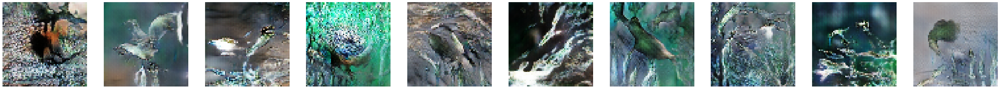

epoch 95
1/1 [==============================] - 0s 16ms/step


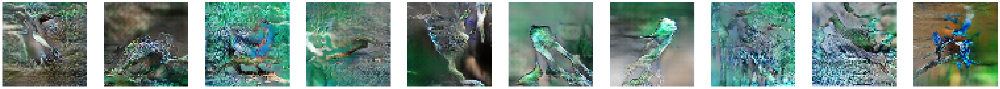

epoch 96
1/1 [==============================] - 0s 16ms/step


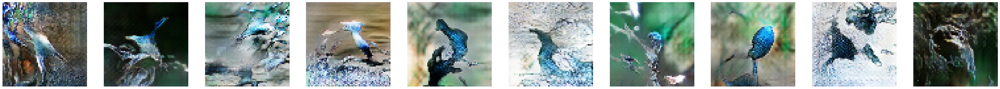

epoch 97
1/1 [==============================] - 0s 16ms/step


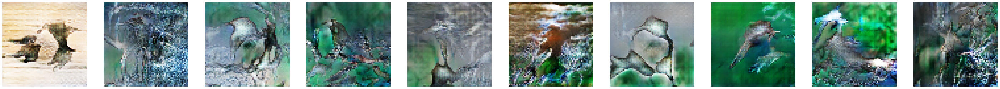

epoch 98
1/1 [==============================] - 0s 14ms/step


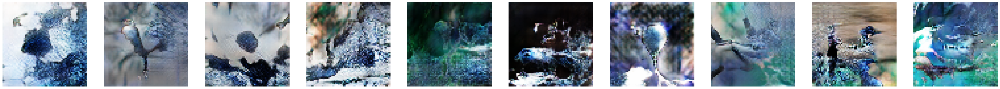

epoch 99
1/1 [==============================] - 0s 15ms/step


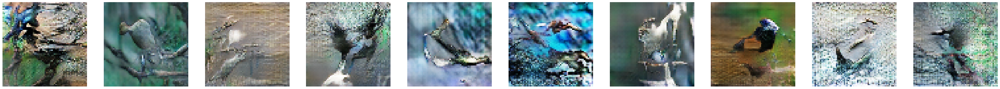

epoch 100
1/1 [==============================] - 0s 16ms/step


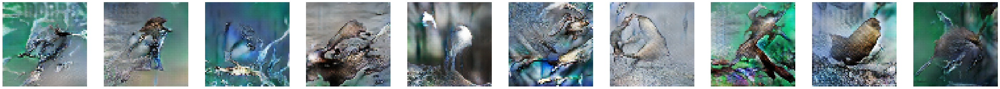

In [66]:
train(100, 64)

1/1 [==============================] - 0s 29ms/step


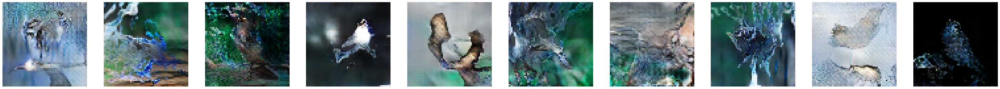

In [67]:
generate()